**GROUP 1 : ASSIGNMENT 1 : GAN**


In [ ]:
import torch
import time
import torch.nn as nn
import torch.optim as optim
import numpy as np
import matplotlib.pyplot as plt
import torchvision.transforms as transforms
import os
import zipfile
import random
from PIL import Image
from torch.utils.data import Dataset, DataLoader,random_split,Tensor_Dataset
from scipy.linalg import sqrtm
from torchvision import transforms, models

In [ ]:
# Device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(device)

cpu


**Organising Data for Butterfly and Animal dataset and also Data Augmentation**

In [ ]:
# We convert the entire dataset into a torch tensor of shape (90,60,3,128,128) and work with this file
# transforms.ToTensor also scales pixel values to be in [0,1]
folder_path = "/content/drive/MyDrive/adrl/training_images.pt"
transform = transforms.Compose([transforms.Resize((128, 128)),transforms.ToTensor()])

# Function to load images as tensors and resize as well
def load_images_as_tensors(folder):
    all_images = []
    i = 0
    # Iterate over subfolders
    for subdir, _, files in os.walk(folder):
        print(i)
        i += 1
        subfolder_images = []
        # Sort files to maintain consistent order
        files.sort()
        for file in files:
            file_path = os.path.join(subdir, file)
            try:
                # Load a single image,resize and then and convert to tensor
                img = Image.open(file_path)
                img_tensor = transform(img)
                subfolder_images.append(img_tensor)
            except Exception as e:
                print(f"Error processing {file_path}: {e}")
        if subfolder_images:
            # Broadcast across all the classes of images
            all_images.append(torch.stack(subfolder_images))
    return torch.stack(all_images)
    # Expected shape is (90, 60, 3, 128, 128)


In [ ]:
# Loading the dataset
# Note that variable name change wrt A1
animal_images = torch.load("/home/sahapthank/saha_adrl/training_images.pt")
butterfly_images = torch.load("/home/sahapthank/saha_adrl/butterfly_training_images.pth")
butterfly_labels = torch.load("/home/sahapthank/saha_adrl/butterfly_training_classindices.pth")
anime_images = torch.load("/home/sahapthank/saha_adrl/anime_faces_images.pt")


In [ ]:
# DATA AUGMENTATION FOR ANIMAL
horizontal_flip = transforms.RandomHorizontalFlip(p=1)    # Randomly flip the image horizontally
rotation = transforms.RandomRotation(degrees=20)    # Random rotation with expanding size
color_jitter = transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1)  # Random color adjustments

tensor_shape = (90,60,3,128,128)
flipped_images = torch.zeros(tensor_shape)
rotated_images = torch.zeros(tensor_shape)
color_jittered_images = torch.zeros(tensor_shape)

for i in range(90):
    for j in range(60):
        flipped_images[i][j] = horizontal_flip(animal_images[i][j])
        rotated_images[i][j] = rotation(animal_images[i][j])
        color_jittered_images[i][j] = color_jitter(animal_images[i][j])

animal_images_augmented = torch.stack([animal_images,flipped_images,rotated_images,color_jittered_images])


In [ ]:
# DATA AUGMENTATION FOR BUTTERFLY
horizontal_flip = transforms.RandomHorizontalFlip(p=1)    # Randomly flip the image horizontally
rotation = transforms.RandomRotation(degrees=20)    # Random rotation with expanding size
color_jitter = transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1)  # Random color adjustments

tensor_shape = (6499,3,128,128)
flipped_images = torch.zeros(tensor_shape)
rotated_images = torch.zeros(tensor_shape)
color_jittered_images = torch.zeros(tensor_shape)

for i in range(6499):
    flipped_images[i] = horizontal_flip(butterfly_images[i])
    rotated_images[i] = rotation(butterfly_images[i])
    color_jittered_images[i]= color_jitter(butterfly_images[i])

butterfly_images_augmented = torch.stack([butterfly_images,flipped_images,rotated_images,color_jittered_images])


In [ ]:
# CHANGE THIS CODE BASED ON DATASET
training_images = torch.reshape(animal_images,(5400,3,128,128))
# Convert values from [0, 1] to [-1, 1]
training_images = ((2 * training_images) - 1)
print(training_images.size())
first_image = (training_images[0] + 1)/2
first_image = first_image.permute(1, 2, 0)
plt.imshow(first_image)
plt.axis('off')
plt.show()
print(torch.min(training_images))


**[Q1, Q2 AND Q3] Vanilla DC-GAN Implementation for 2 datasets**

**CRITIC NETWORK (Denote by D/T)**

* Below is a DC-GAN where the Critic does not have any FFNN and relies only on Strided Convolutions(instead of Pooling) to continuously downsample the image input to a single real value (which is converted to Probability using Sigmoid)
* BatchNormalisation and Activation functions are chosen as in the DC-GAN paper and there are no skip connections
* The class instantiation is made flexible by making the architectural parameters as inputs

In [ ]:
class Critic_DCGAN(nn.Module):
    def __init__(self,architecture):
        # architecture = [conv_params , use_batchnorm, activation_fn]
        # conv_params = [[in_channels,output_channels,kernel_size,stride,padding],....[*,1,*,*,*]]
        # use_batchnorm = [False,True,....False]
        # activation_fn = [nn.Relu,nn.LeakyRelu,.....nn.sigmoid()]
        super(Critic_DCGAN, self).__init__()
        assert len(architecture[0]) == len(architecture[1]) == len(architecture[2])
        self.conv_params = architecture[0]
        self.use_batchnorm = architecture[1]
        self.activation_fn = architecture[2]
        layers = []
        for j,i in enumerate(self.conv_params):
            layers.append(nn.Conv2d(in_channels=i[0],out_channels=i[1],kernel_size=i[2],stride=i[3],padding=i[4]))
            if (self.use_batchnorm)[j]:
                layers.append(nn.BatchNorm2d(i[1]))
            layers.append(self.activation_fn[j])
        # The last conv2d layer outputs [1,1,1]
        # Sigmoid is the last activation function
        # the * operator is used to unpack a list or tuple into separate positional arguments
        self.model = nn.Sequential(*layers)

    # Below function just asks the opinion of T
    # Return value must be in dom(f*)
    def forward(self, x):
        return self.model(x)

    # We will use this to prevent calculating gradients wrt parameters of T
    # During training the generator G
    def set_requires_grad(self, requires_grad):
        for param in self.parameters():
            param.requires_grad = requires_grad


In [ ]:
# Example instantiation used in the DC-GAN paper where no BatchNormalisation at the beginning and end
# Assuming input is [3,128,128] final output is [1024,4,4] then a final Conv2d to give [1,1,1]
# output_size = ({input_size - kernel_size + 2*padding}/stride) + 1
# TRIAL 1
# conv_params_1 = [[3,64,4,2,1],[64,128,4,2,1],[128,256,4,2,1],[256,512,4,2,1],[512,1024,4,2,1],[1024,1,4,4,1]]
# use_batchnorm_1 = [True for _ in range(5)] + [False]
# activation_fn_1 = [nn.LeakyReLU(0.2, inplace=False) for _ in range(5)] +[nn.Sigmoid()]
# architecture_1 = [conv_params_1,use_batchnorm_1,activation_fn_1]

# TRIAL 2
# conv_params_1= [[3,32,4,2,1],[32,64,1,1,0],[64,64,4,2,1],[64,128,4,4,0],[128,1,8,1,0]]
# use_batchnorm_1 = [True for _ in range(4)] + [False]
# activation_fn_1= [nn.LeakyReLU(0.2, inplace=False) for _ in range(4)] +[nn.Sigmoid()]
# architecture_1= [conv_params_1,use_batchnorm_1,activation_fn_1]

# TRIAL 3
# conv_params_1 = [[3,32,4,2,1],[32,64,4,2,1],[64,64,4,2,1],[64,128,4,2,1],[128,256,4,2,1],[256,1,4,4,1]]
# use_batchnorm_1 = [True for _ in range(5)] + [False]
# activation_fn_1 = [nn.LeakyReLU(0.2, inplace=False) for _ in range(5)] +[nn.Sigmoid()]
# architecture_1 = [conv_params_1,use_batchnorm_1,activation_fn_1]

# TRIAL 4
conv_params_1 = [[3,32,4,2,1],[32,64,4,2,1],[64,128,4,2,1],[128,128,4,2,1],[128,256,4,2,1],[256,1,4,4,1]]
use_batchnorm_1 = [True for _ in range(5)] + [False]
activation_fn_1 = [nn.LeakyReLU(0.2, inplace=False) for _ in range(5)] +[nn.Sigmoid()]
architecture_1 = [conv_params_1,use_batchnorm_1,activation_fn_1]


**GENERATOR NETWORK (Denote by G)**


* Strided 2D-Convolutional transpose layers are being used to up-sample latent space vectors to images
*  Existence of the BatchNorm after the Conv-transpose layers is the critical contribution of the DCGAN paper which helps in the flow of the gradients during training





In [ ]:
class Generator_DCGAN(nn.Module):
    def __init__(self, architecture):
        super(Generator_DCGAN, self).__init__()
        assert len(architecture[0]) == len(architecture[1]) == len(architecture[2])
        self.transpose_conv_params = architecture[0]
        self.use_batchnorm = architecture[1]
        self.activation_fn = architecture[2]
        layers = []
        # Starting with input latent vector (e.g., size 100)
        for j, i in enumerate(self.transpose_conv_params):
            layers.append(nn.ConvTranspose2d(in_channels=i[0], out_channels=i[1], kernel_size=i[2], stride=i[3], padding=i[4]))
            if self.use_batchnorm[j]:
                layers.append(nn.BatchNorm2d(i[1]))
            layers.append(self.activation_fn[j])
        # tanh() us used as the final activation function
        self.model = nn.Sequential(*layers)

    # Sampling images from the generator G
    def forward(self, x):
        return self.model(x)

    # We will use this to prevent calculating gradients wrt parameters of G
    # During training the discriminator T
    def set_requires_grad(self, requires_grad):
        for param in self.parameters():
            param.requires_grad = requires_grad


In [ ]:
# Example instantiation used in the DC-GAN paper where no BatchNormalisation at the beginning
# Assuming input is [100,1,1] final output is [3,64,64]
# output_size = {(input_size - 1) * stride} - (2*padding) + kernel_size}
# TRIAL 1
# transpose_conv_params_2 = [[100,512,4,1,0],[512,256,4,2,1],[256,128,4,2,1],[128,64,4,2,1],[64,32,4,2,1],[32,3,4,2,1]]
# use_batchnorm_2 = [True for _ in range(5)] + [False]
# activation_fn_2 = [nn.ReLU(inplace = False) for _ in range(5)] +[nn.Tanh()]
# architecture_2 = [transpose_conv_params_2, use_batchnorm_2, activation_fn_2]

# TRIAL 2
# transpose_conv_params_2 = [[100,256,4,1,0],[256,128,4,2,1],[128,64,4,2,1],[64,32,4,2,1],[32,3,4,4,0]]
# use_batchnorm_2 = [True for _ in range(4)] + [False]
# activation_fn_2 = [nn.ReLU(inplace = False) for _ in range(4)] +[nn.Tanh()]
# architecture_2 = [transpose_conv_params_2, use_batchnorm_2, activation_fn_2]

# TRIAL 3
transpose_conv_params_2 = [[200,512,4,1,0],[512,256,4,2,1],[256,128,4,2,1],[128,64,4,2,1],[64,32,4,2,1],[32,3,4,2,1]]
use_batchnorm_2 = [True for _ in range(5)] + [False]
activation_fn_2 = [nn.ReLU(inplace = False) for _ in range(5)] +[nn.Tanh()]
architecture_2 = [transpose_conv_params_2,use_batchnorm_2,activation_fn_2]


**Generator using BilinearInterpolation and Conv2d**

In [ ]:
class Generator_BilinearUpsample(nn.Module):
    def __init__(self, architecture):
        super(Generator_BilinearUpsample, self).__init__()
        assert len(architecture[0]) == len(architecture[1]) == len(architecture[2])
        self.conv_params = architecture[0]
        self.use_batchnorm = architecture[1]
        self.activation_fn = architecture[2]
        self.Bilinear_size = architecture[3]
        layers = []
        # Starting with input latent vector (e.g., size 100)
        # Upsampling done on h,w input is (bs,c,h,w)
        for j, i in enumerate(self.conv_params):
            layers.append(nn.Upsample(scale_factor = self.Bilinear_size[j], mode='bilinear', align_corners=False))
            layers.append(nn.Conv2d(in_channels=i[0],out_channels=i[1],kernel_size=i[2],stride=i[3],padding=i[4]))
            if self.use_batchnorm[j]:
                layers.append(nn.BatchNorm2d(i[1]))
            layers.append(self.activation_fn[j])
        # tanh() us used as the final activation function
        self.model = nn.Sequential(*layers)

    def forward(self, x):
        return self.model(x)

    # We will use this to prevent calculating gradients wrt parameters of G
    # During training the discriminator T
    def set_requires_grad(self, requires_grad):
        for param in self.parameters():
            param.requires_grad = requires_grad


In [ ]:
# Example instantiation used in the DC-GAN paper where no BatchNormalisation at the beginning
# Assuming input is [100,1,1] final output is [3,64,64]
# output_size = ({input_size - kernel_size + 2*padding}/stride) + 1
# We take (s=1 and k=3 to match 2p = 2)
Bilinear_size_3 = [1,2,2,2,4,4]
conv_params_3 = [[100,512,1,1,0],[512,256,3,1,1],[256,128,3,1,1],[128,64,3,1,1],[64,32,3,1,1],[32,3,3,1,1]]
use_batchnorm_3 = [True for _ in range(5)] + [False]
activation_fn_3 = [nn.ReLU(inplace = False) for _ in range(5)] + [nn.Tanh()]
architecture_3 = [conv_params_3, use_batchnorm_3, activation_fn_3 ,Bilinear_size_3]

# TRIAL 2
# TO BE ADDED

In [ ]:
G_2 = Generator_BilinearUpsample(architecture_3)
random_tensor = torch.randn((5,100,1,1))
random_output = G_2(random_tensor)
print(random_output.shape)
TP2 = sum(p.numel() for p in G_2.parameters())
print(TP2)


**Sampling from various distributions**

In [ ]:
# Sample from a Gaussian for inference
def sample_gaussian(mean, covariance_matrix , n_samples):
    # mean should be of size ([d])
    # variance is the covariance matrix of size ([d,d]) must be +ve semidefinite
    z = torch.distributions.MultivariateNormal(mean,covariance_matrix)
    return z.sample([n_samples])
    # returns of size ([n_samples,d])

# Sample from "CURRENT TRAINING IMAGES"
def sample_train(n_samples):
    i_indices = torch.randint(0, training_images.size(0), (n_samples,)).tolist()
    sampled_images = []
    for i in i_indices:
        sampled_images.append(training_images[i])
    sampled_images_tensor = torch.stack(sampled_images)
    return sampled_images_tensor

# Sample from Real_images [BUTTERFLY]
def sample_real_butterfly(n_samples):
    i_indices = torch.randint(0, 6499, (n_samples,)).tolist()
    sampled_images = []
    for i in i_indices:
        sampled_images.append(butterfly_images[i])
    sampled_images_tensor = torch.stack(sampled_images)
    return sampled_images_tensor

# Sample from Real_images [ANIMAL]
def sample_real_animal(n_samples):
    i_indices = torch.randint(0, 90, (n_samples,)).tolist() # chooses class
    j_indices = torch.randint(0, 60, (n_samples,)).tolist() # chooses image in class
    sampled_images = []
    for i, j in zip(i_indices, j_indices):
        sampled_images.append(animal_images[i, j])
    sampled_images_tensor = torch.stack(sampled_images)
    return sampled_images_tensor

# Sample from Real_images [ANIMAL] including augmented
def sample_real_augmented_animal(n_samples):
    i_indices = torch.randint(0, 90, (n_samples,)).tolist() # chooses class
    j_indices = torch.randint(0, 60, (n_samples,)).tolist() # chooses image in class
    k_indices = torch.randint(0, 4, (n_samples,)).tolist() # chooses augmentation type
    sampled_images = []
    for i, j , k in zip(i_indices, j_indices , k_indices):
        sampled_images.append(animal_images_augmented[k, i, j])
    sampled_images_tensor = torch.stack(sampled_images)
    return sampled_images_tensor

# Sample from Real_images [BUTTERFLY] including augmented
def sample_real_augmented_butterfly(n_samples):
    i_indices = torch.randint(0, 6499, (n_samples,)).tolist() # chooses image
    k_indices = torch.randint(0, 4, (n_samples,)).tolist() # chooses augmentation type
    sampled_images = []
    for i, k in zip(i_indices, k_indices):
        sampled_images.append(butterfly_images_augmented[k, i])
    sampled_images_tensor = torch.stack(sampled_images)
    return sampled_images_tensor

# Sample from Real_images [ANIME]
def sample_real_anime(n_samples):
    i_indices = torch.randint(0, 21551, (n_samples,)).tolist()
    sampled_images = []
    for i in i_indices:
        sampled_images.append(anime_images[i])
    sampled_images_tensor = torch.stack(sampled_images)
    return sampled_images_tensor


**DC-GAN Training Algorithm**

**Experiments and Observations on using Vanilla DC-GAN**

* Using DC-GAN architecture with the loss function mentioned in the original GAN paper the gradients quickly became zero for both the generator and discriminator. So the modified loss function of max (log(D(G(z))) instead of minimising (log(1-D(G(z)) improved the training stability, but still G_loss kept fluctuating a bit and D_loss seems to be hovering around zero when n_critic = 5.
* Even after implementing the (-logD) trick still at times the loss function explodes to "nan" in between of the training or else the D_loss stays zero and G_loss doesnt decrease and stays quite high.So we need to move to W-GAN or try various hyperparameters and architectures.




In [ ]:
"""Assuming "Critic/Discriminator/D" and "Generator/G" are defined as classes derived from nn.Module
Hyperparameters := {lr,mini_batch_size,# D updates per G update,latent_space dimesnion} to be chosen for optimisation"""

# Initialize model, loss function, and optimizer
lr_D, lr_G, m, n_critic, d = 2e-4, 2e-4, 128, 5, 100
D_architecture = architecture_1
G_architecture = architecture_2
D = Critic_DCGAN(D_architecture).to(device)
G = Generator_DCGAN(G_architecture).to(device)
D_loss = []
G_loss = []

# We will use 2 optimizers for convenience
# Adam optimizer
D_optimizer = optim.Adam(D.parameters(), lr=lr_D, betas=(0.5, 0.99), eps=1e-8, weight_decay=0)
G_optimizer = optim.Adam(G.parameters(), lr=lr_G, betas=(0.5, 0.99), eps=1e-8, weight_decay=0)
# RMSPROP
# D_optimizer = optim.RMSprop(D.parameters(), lr = lr_D, alpha=0.99, eps=1e-08, weight_decay=0, momentum=0, centered=False)
# G_optimizer = optim.RMSprop(G.parameters(), lr = lr_G, alpha=0.99, eps=1e-08, weight_decay=0, momentum=0, centered=False)


In [ ]:
# This part is used for manual changing if needed inbetween of the training
lr_D, lr_G, m, d = 1e-4 , 1e-4 , 128, 100
D_optimizer = optim.Adam(D.parameters(), lr=lr_D, betas=(0.5, 0.99), eps=1e-8, weight_decay=0)
G_optimizer = optim.Adam(G.parameters(), lr=lr_G, betas=(0.5, 0.99), eps=1e-8, weight_decay=0)


In [ ]:
num_epochs = 20
n_critic = 5
n_generator = 1
mini_batch_epochs = 50
epsilon = 1e-15
# Training loop
for epoch in range(num_epochs):
    for _ in range(mini_batch_epochs):
    # start = time.time()
    # We will track image quality and gradient norm and decide when to halt
        for t in range(n_critic):
            """How freezing works in Pytorch:
            In the forward pass, torch.no_grad()/reqd_grad = False will prevent the computation of gradients for the frozen layers.
            However, in the backward pass, gradients will still flow through them
            but the optimizer won't update its parameters because they are marked as not requiring gradient
            The parameter gradients, which are not needed, won’t be computed (their .grad attribute won’t be updated)
            But the gradient calculation will continue, if it’s needed for earlier layers."""
            G.set_requires_grad(False)
            D.set_requires_grad(True)
            D_optimizer.zero_grad()
            G_optimizer.zero_grad()
            x = sample_train(m).to(device)
            z = (sample_gaussian(torch.zeros((d,)),torch.eye(d),m)).unsqueeze(-1).unsqueeze(-1).to(device)
            y = G(z)
            # f-GAN objective F(θ,w) maximizes wrt w and minimises wrt θ
            # Compute gradients for D where loss_D is a 0-dimensional tensor
            loss_D = -((torch.log(D(x) + epsilon)).mean() + (torch.log(1 - D(y) + epsilon)).mean())
            loss_D.backward()
            D_optimizer.step()
            D_optimizer.zero_grad()

        for t in range(n_generator):
            # Sample another batch of noise z from prior p(z)
            G.set_requires_grad(True)
            D.set_requires_grad(False)
            D_optimizer.zero_grad()
            G_optimizer.zero_grad()
            z1 = (sample_gaussian(torch.zeros((d,)),torch.eye(d),m)).unsqueeze(-1).unsqueeze(-1).to(device)
            y1 = G(z1)
            # Compute gradients for G
            loss_G = -(torch.log(D(y1) + epsilon)).mean()
            loss_G.backward()
            G_optimizer.step()
            G_optimizer.zero_grad()

        D_loss.append(loss_D.item())
        G_loss.append(loss_G.item())
        # Optional: Logging after each epoch
        # print(f"Epoch [{epoch+1}/{num_epochs}] | D Loss: {loss_D.item():.4f} | G Loss: {loss_G.item():.4f}")
        # stop = time.time()
        # print(stop - start)


In [ ]:
# Plotting the Loss curves so far
# Create a figure with two subplots (1 row, 2 columns)
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(12, 6))
# Plot D_loss in the first subplot
D_steps = range(len(D_loss))
ax1.plot(D_steps, D_loss)
ax1.set_xlabel('Mini-Batch')
ax1.set_ylabel('loss')
ax1.set_title('D_loss')
# Plot G_loss in the second subplot
G_steps = range(len(G_loss))
ax2.plot(G_steps, G_loss)
ax2.set_xlabel('Mini-Batch')
ax2.set_ylabel('loss')
ax2.set_title('G_loss')
# Display the plots
plt.tight_layout()
plt.show()


In [ ]:
# Inference
with torch.no_grad():
    z = (sample_gaussian(torch.zeros((d,)),torch.eye(d),100)).unsqueeze(-1).unsqueeze(-1).to(device)
    y = (G(z) + 1) / 2
    images = y.detach().cpu().numpy()
    # Create a figure for the grid of images
    fig, axes = plt.subplots(nrows=10, ncols=10, figsize=(15, 15))
    # Loop through the 100 images and display them in the grid
    for i, ax in enumerate(axes.flat):
        img = images[i].transpose(1, 2, 0)
        ax.imshow(img)
        ax.axis('off')
    plt.tight_layout()
    plt.show()


**FOLLOWING WAS THE BEST DCGAN IMAGES OBTAINED FOR BUTTERFLY DATASET**
* D has 760,929 params and G has 3,608,995 params . Latent_dim = d = 100 ; lr = 2e-4 ; m = 128 ; Adam Optimizer with (0.5,0.99) was used.
* Less parameters in G caused very blurry images and making D,G somewhat equally powerful seems to give best results.
* Augmentation was not used . {n_critic and n_generator} were varied manually every 20/30 epochs taking {5,1},{5,2},{5,3} values progressively.

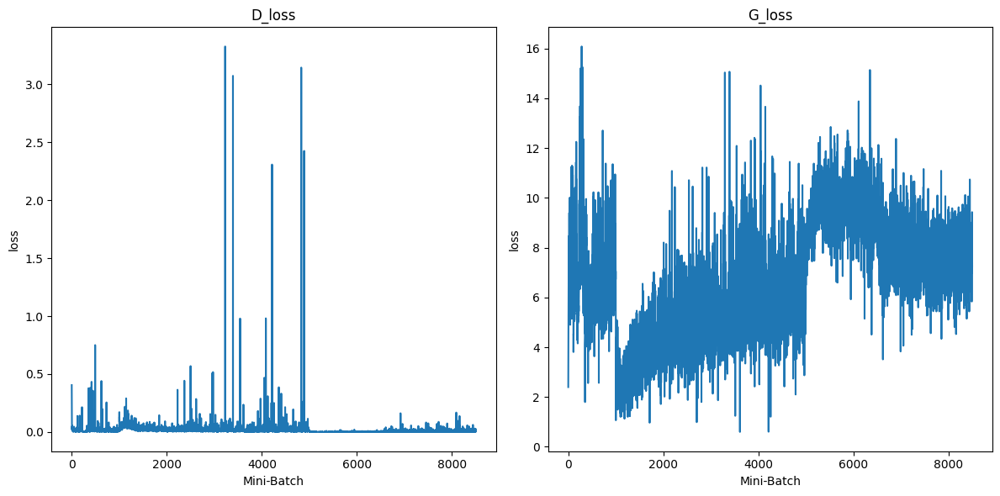

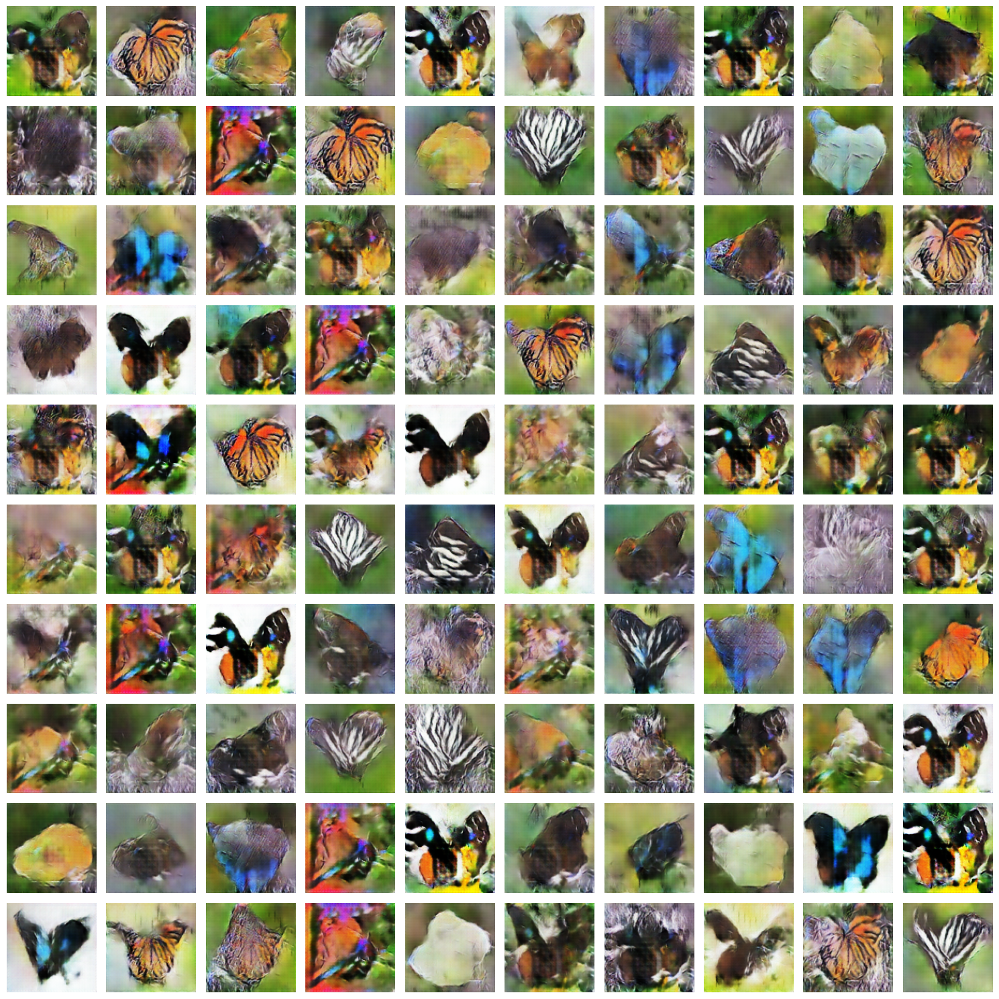

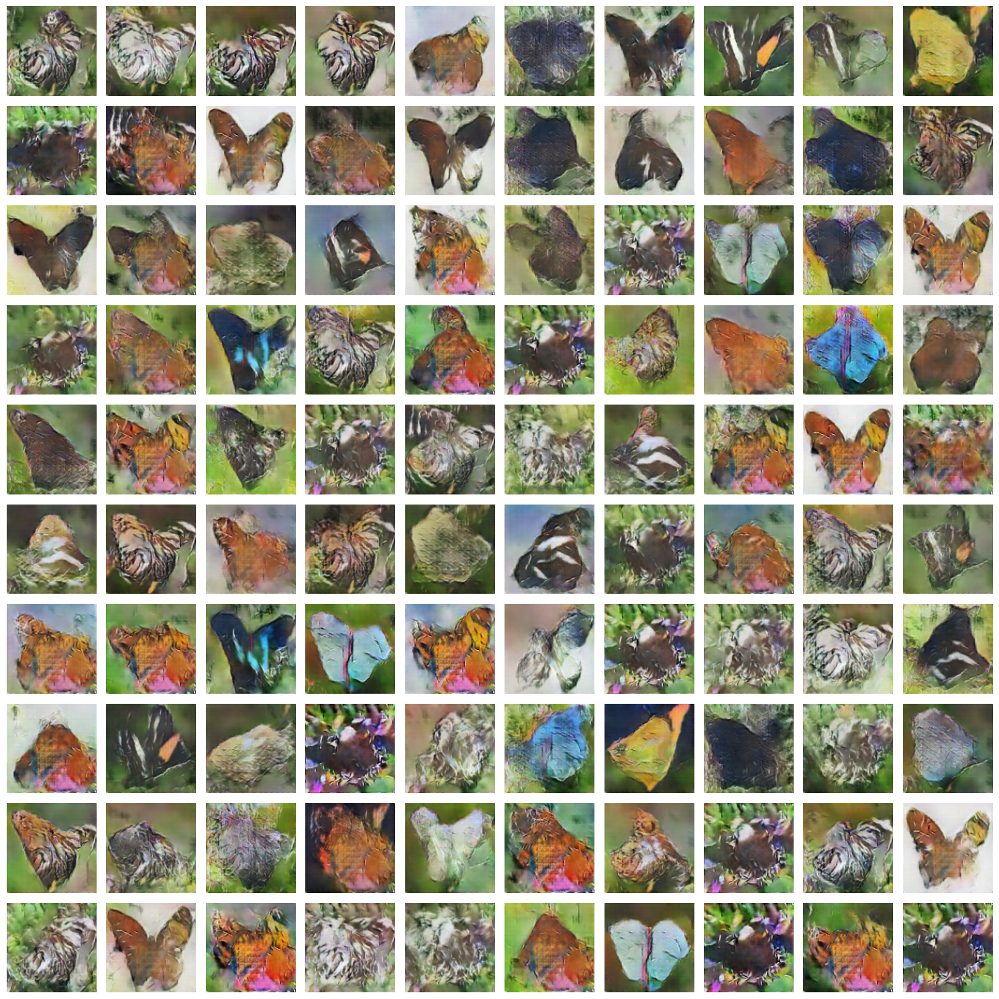

**FOLLOWING WAS THE BEST DCGAN IMAGES OBTAINED FOR ANIMAL DATASET**
* Same hyperparameters as the [butterfly-best] was used along with augmentations{flip,colour-jitter,rotations} for the first 130 epochs and then only flip was used.
* Animal images seemed to require more iterations when using augmentations and also seem to require More parameters to model the distribution due to much higher variety than butterflies.



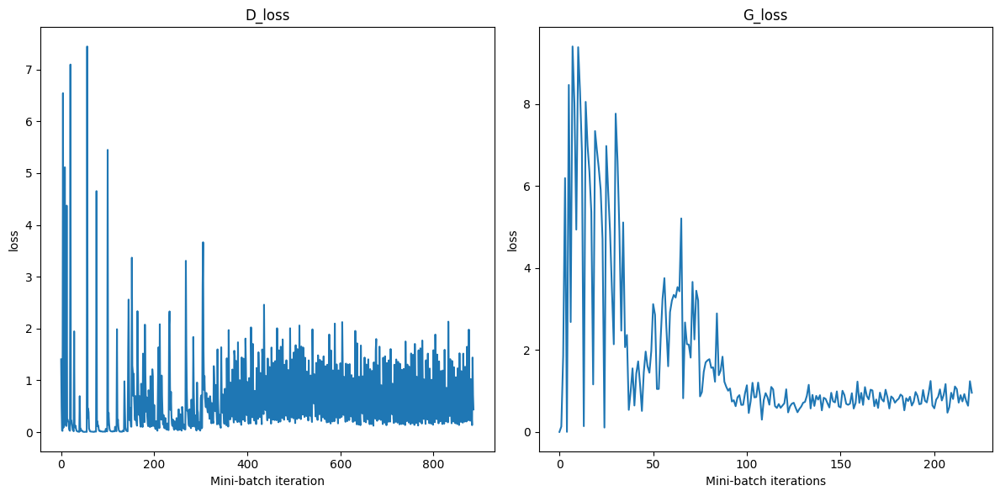

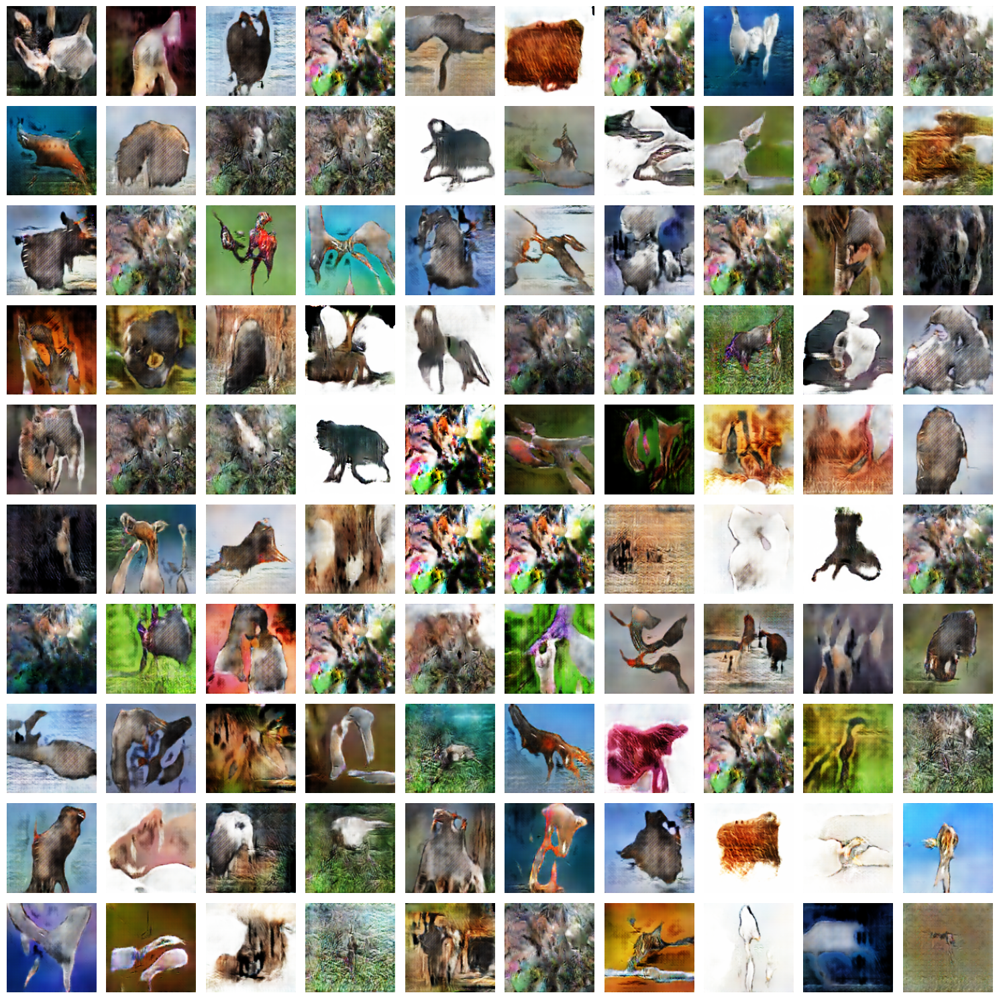

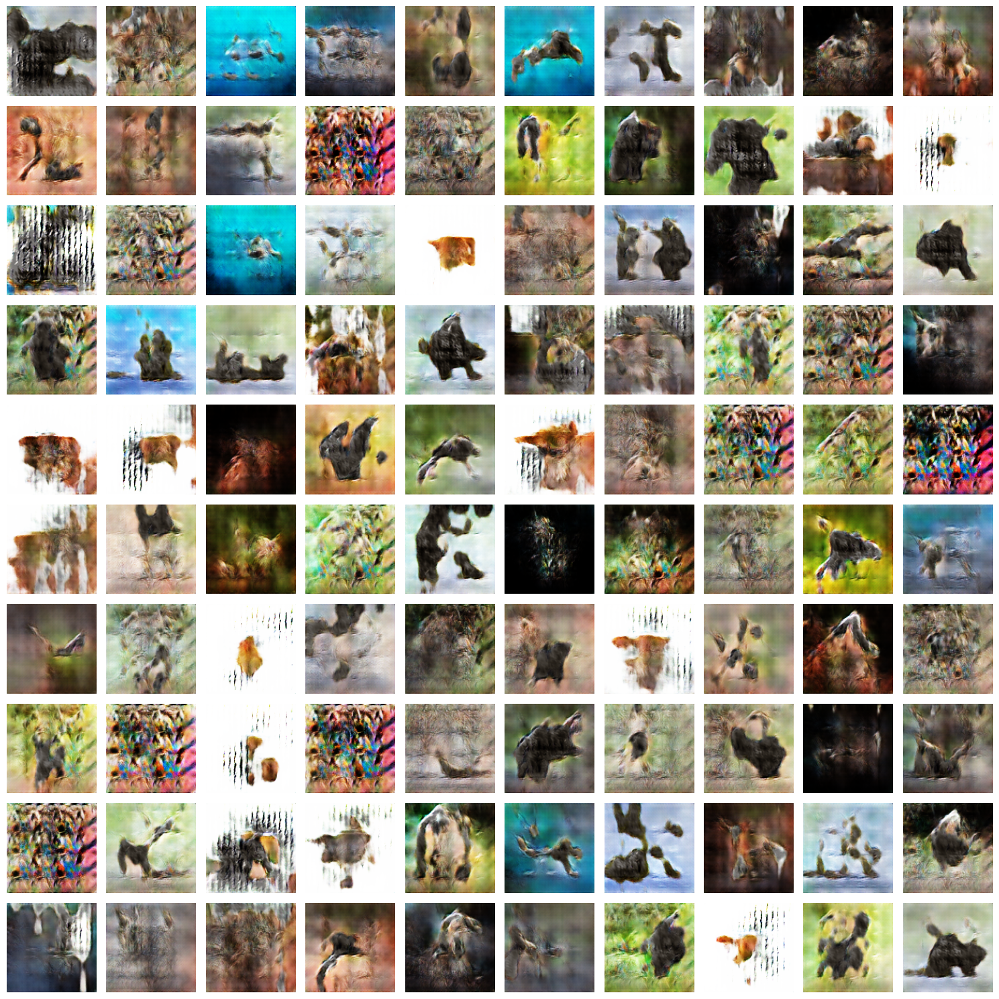

**Increasing Dimension of LatentSpace**

* Increasing the dimension of input latent space to d = 200 and using a different architecture for D,G some slight imporvements seem to happen visually but image quality is still not recognisable and loss function saturates
* Below are few images of d = 200




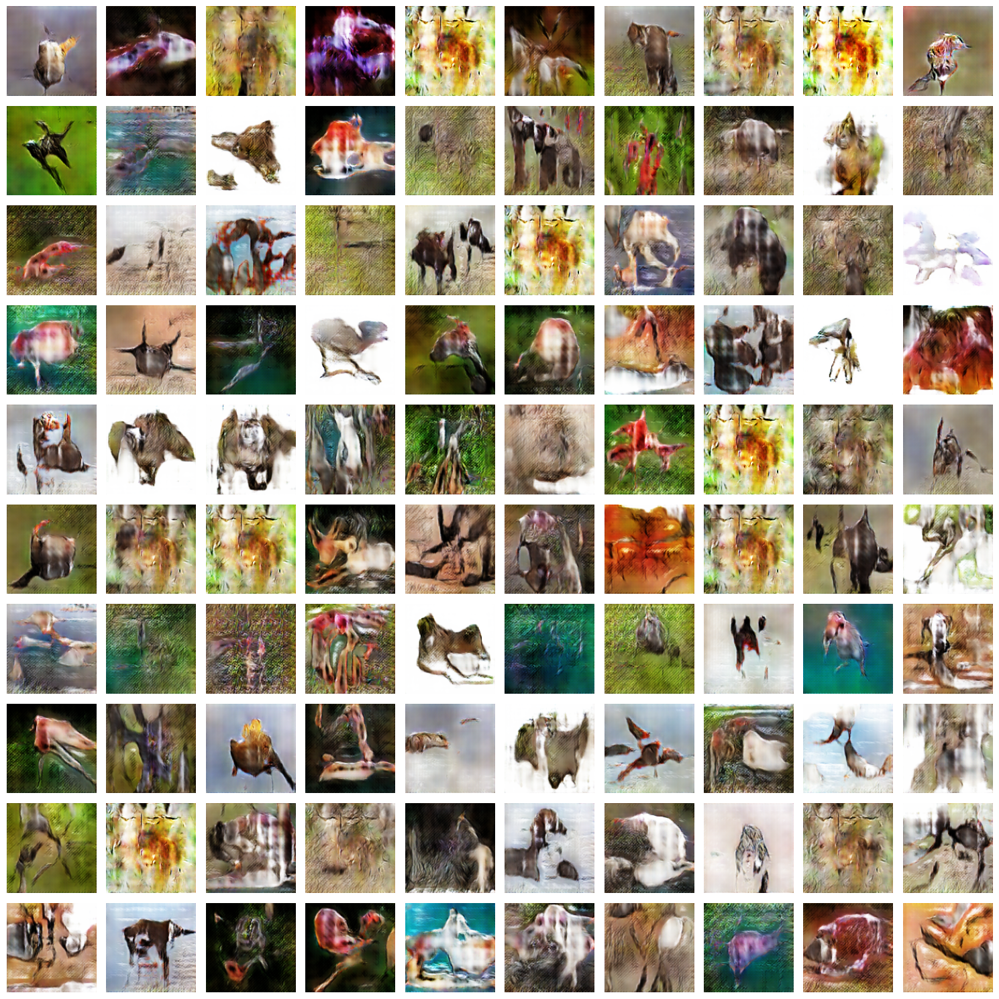